# [Spotify Project - Group 12]

**Group Members:**

- Deniz Umut Eser
- Miraç Deniz Gözen
- Ali Koray Cankı

## Introduction

The dataset we are working with provides us with many songs with pre-calculated features along with the genre information, which unlocks a great potential to analyze how these observations change with different genres, artists, years etc. Firstly, we would like to examine whether there is a relationship between those observations. Therefore, we plot charts and check if our ideas are valid. After those testings we are aiming to recommend songs based on those correlations to help people discover new songs that suits their tastes.


## Imports:

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
import re
from sklearn import datasets
from os.path import join
from scipy.stats import f_oneway
from scipy import stats
from scipy import special
from pprint import pprint



#ml
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from os.path import join
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import PolynomialFeatures
from sklearn import tree
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV



from google.colab import drive
drive.mount('/content/drive')

%matplotlib inline

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Utilized Datasets


##Spotify Dataset 1921-2020, 160k+ Tracks

Source: https://www.kaggle.com/yamaerenay/spotify-dataset-19212020-160k-tracks 

---


In [ ]:
df = pd.read_csv('/content/drive/My Drive/cs210/data.csv')
df.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0hbkKFIJm7Z05H8Zl9w30f,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,11m7laMUgmOKqI3oYzuhne,0.000018,0,0.5190,-12.098,1,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,19Lc5SfJJ5O1oaxY0fpwfh,0.801000,2,0.1280,-7.311,1,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,2hJjbsLCytGsnAHfdsLejp,0.000246,10,0.4020,-6.036,0,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


###General Format of the dataset:

In [ ]:
rows = df.shape[0]
columns = df.shape[1]
print("Number of rows:", rows, "Number of columns:", columns)

Number of rows: 174389 Number of columns: 19


Types of observations:

In [ ]:
df.dtypes

acousticness        float64
artists              object
danceability        float64
duration_ms           int64
energy              float64
explicit              int64
id                   object
instrumentalness    float64
key                   int64
liveness            float64
loudness            float64
mode                  int64
name                 object
popularity            int64
release_date         object
speechiness         float64
tempo               float64
valence             float64
year                  int64
dtype: object

#### Sub datasets of the main dataset:

In [ ]:
df_artist = pd.read_csv('/content/drive/My Drive/cs210/data_by_artist.csv')
df_artist.head()

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
0,"""Cats"" 1981 Original London Cast",0.598500,0.470100,267072.000000,0.376203,0.010261,0.283050,-14.434300,0.209150,114.128800,0.358320,38.200000,5,1,10
1,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,31.538462,5,1,26
2,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.571429,0,1,7
3,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.407407,0,1,27
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,42.000000,5,1,7


In [ ]:
df_year = pd.read_csv('/content/drive/My Drive/cs210/data_by_year.csv')
df_year.head()

,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
0,1920,0.631242,0.515750,238092.997135,0.418700,0.354219,0.216049,-12.654020,0.082984,113.226900,0.498210,0.610315,2,1
1,1921,0.862105,0.432171,257891.762821,0.241136,0.337158,0.205219,-16.811660,0.078952,102.425397,0.378276,0.391026,2,1
2,1922,0.828934,0.575620,140135.140496,0.226173,0.254776,0.256662,-20.840083,0.464368,100.033149,0.571190,0.090909,5,1
3,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.205405,0,1
4,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10,1


In [ ]:
df_genres = pd.read_csv('/content/drive/My Drive/cs210/data_by_genres.csv')
df_genres.head()

,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode
0,21st century classical,0.754600,0.284100,3.525932e+05,0.159580,0.484374,0.168580,-22.153400,0.062060,91.351000,0.143380,6.600000,4,1
1,432hz,0.485515,0.312000,1.047430e+06,0.391678,0.477250,0.265940,-18.131267,0.071717,118.900933,0.236483,41.200000,11,1
2,8-bit,0.028900,0.673000,1.334540e+05,0.950000,0.630000,0.069000,-7.899000,0.292000,192.816000,0.997000,0.000000,5,1
3,[],0.535793,0.546937,2.495312e+05,0.485430,0.278442,0.220970,-11.624754,0.101511,116.068980,0.486361,12.350770,7,1
4,a cappella,0.694276,0.516172,2.018391e+05,0.330533,0.036080,0.222983,-12.656547,0.083627,105.506031,0.454077,39.086248,7,1


In [ ]:
df_wgenres = pd.read_csv('/content/drive/My Drive/cs210/data_w_genres.csv')
df_wgenres.head()

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,genres
0,"""Cats"" 1981 Original London Cast",0.598500,0.470100,267072.000000,0.376203,0.010261,0.283050,-14.434300,0.209150,114.128800,0.358320,38.200000,5,1,10,['show tunes']
1,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,31.538462,5,1,26,[]
2,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.571429,0,1,7,[]
3,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.407407,0,1,27,[]
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,42.000000,5,1,7,[]



###Data cleaning

In [ ]:
#df = pd.read_csv('/content/drive/My Drive/cs210/data.csv')
#df = df.drop(['id', 'key', 'mode'], axis = 1)
#df.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,instrumentalness,liveness,loudness,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0.000522,0.3790,-12.628,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0.026400,0.0809,-7.261,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,0.000018,0.5190,-12.098,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,0.801000,0.1280,-7.311,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,0.000246,0.4020,-6.036,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


### Plots to understand the dataset:

For example, from the first observation we can see that accusticness decreased over time.

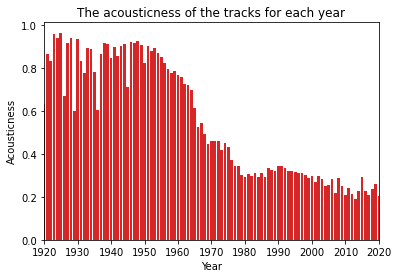

In [ ]:
plt.bar(df_year.year, df_year.acousticness, color="tab:red")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Acousticness")
plt.title("The acousticness of the tracks for each year")
plt.show()

The graph we plot above shows the change in Acousticness of the tracks over the years 1920 to 2020. The x axis represents the years and y axis the acousticness. We would like to focus your attention on two important thing. The first one is in general, between Acousticnes of the tracks for each year and year, there is a negative correlation, and second important thing is there is a sudden drop between 1960 to 1980.

Also, Instrumentalness fluctuated between the years.

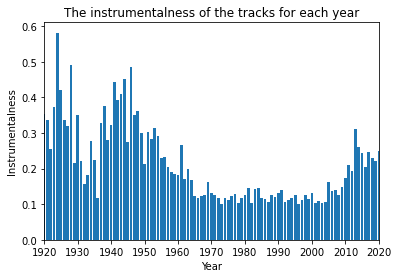

In [ ]:
plt.bar(df_year.year, df_year.instrumentalness)
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Instrumentalness")
plt.title("The instrumentalness of the tracks for each year")
plt.show()
#sns.barplot(df_year.year, df_year.instrumentalness) # sns alternative

The graph we plot above shows the change instrumentalness of the tracks over the year 1920 to 2020. The x axis represents the year and y axis instrumentalness. Between 1920's and 1930s, there is a sharp drop and after 1930s there is a gradually rise. From 1960 to 1960 we can say that insturamentallnes has remained reasonably stable within the range 0.1 to 0.2. Overally, it can be concluded that there is no certain correlation among insturumentallnes and year.

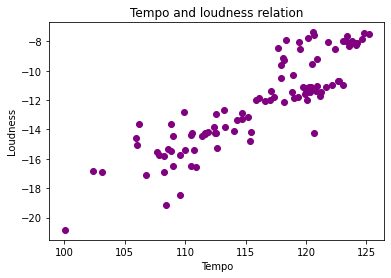

In [ ]:
plt.scatter(df_year.tempo, df_year.loudness, color ="purple")
plt.xlabel("Tempo")
plt.ylabel("Loudness")
plt.title("Tempo and loudness relation")
plt.show()

The graph we plot above helps us to understand whether there is a relationship between Loudness and Tempo or not. The x axis represents the tempo and y axis loudness. If we look at this graph on Tempo and loudness generally it can be said that there is a positive correlation among Tempo and Loudness.

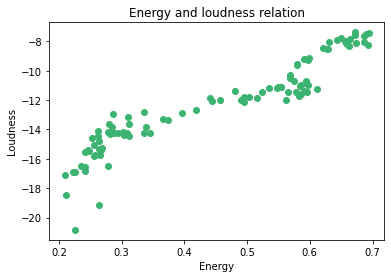

In [ ]:
plt.scatter(df_year.energy, df_year.loudness, color ="mediumseagreen")
plt.xlabel("Energy")
plt.ylabel("Loudness")
plt.title("Energy and loudness relation")
plt.show()

The graph we plot above shows the change in Loudness over the energy. It helps us to understand whether ther is a relationship between them. The x axis represents Energy for each year and y axis Loudness for each year. What you can see from the graph is there is a strong positive correlation among Loudness and Energy. Furthermore, it can be seen that there is a sharp increase starting from 0.6 Energy range.

## Exploratory Data Analysis



### Visualizations Descriptive Statistics

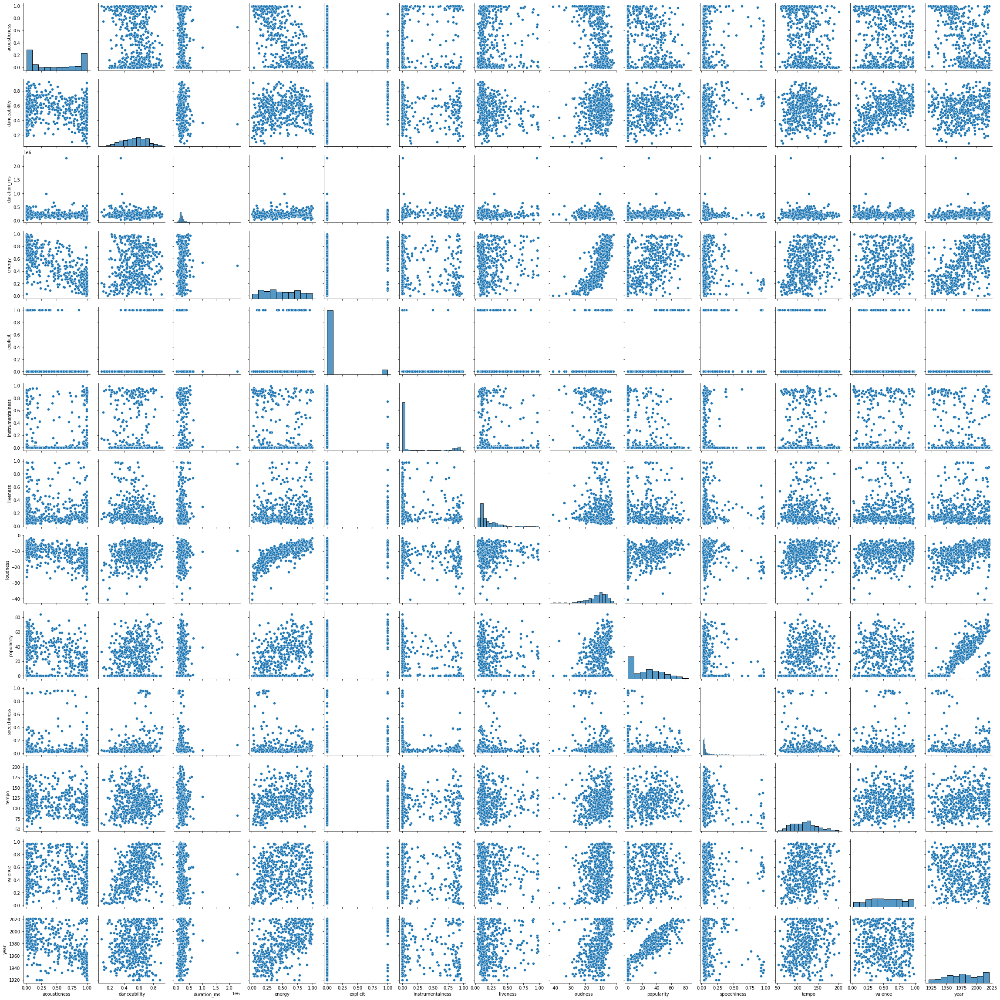

In [ ]:
sns.pairplot(df.sample(500));

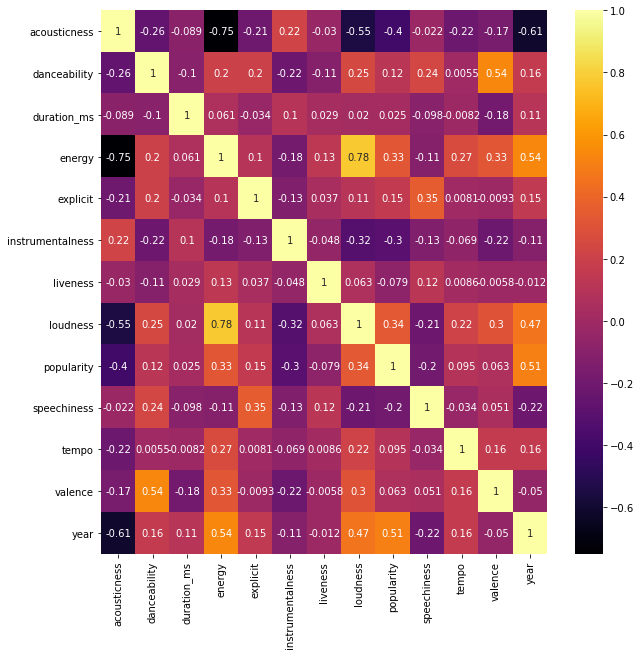

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(df.corr("pearson"),annot = True,cmap = "inferno");

Heatmap of the dataset clearly shows the main correlations between the observations.

### Visualizations of Aggregated Forms Based on Features

Explicit tracks are more popular than non-explicit ones

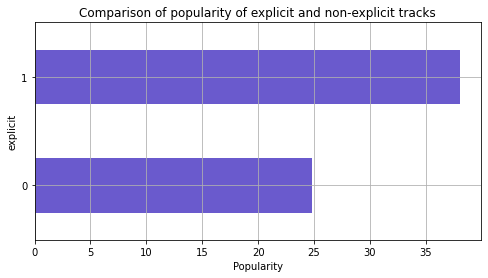

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(8, 4))
ax = df.groupby(by = 'explicit')['popularity'].mean().sort_values().plot.barh(grid= True, color = "slateblue")
ax.set_xlabel("Popularity")
plt.title("Comparison of popularity of explicit and non-explicit tracks"); #explicitness and speechiness are weak to moderate positively correlated which makes sense.

The graph we plot above compare the popularity of the explict and nonexplict tracks. The x axes represents popularity and y axes explicit. From the graph it can be concluded that generally, explicit tracks has more popularity then non-explicit tracks.

In [ ]:
emf = df_year[["year","acousticness","energy","valence"]].copy()

# activation functions to nomalize values
def tanh(x):
  result = (np.exp(x)-np.exp(-1*x))/(np.exp(x)+np.exp(-1*x))
  return result

emotion = df_year["acousticness"]*df_year["energy"]*df_year["valence"] # emotional state = acousticness * energy * valence
emf["emotion"] = tanh(emotion) # normalizes the emotion value with the help of tanh function
emf.head(10)

,year,acousticness,energy,valence,emotion
0,1920,0.631242,0.418700,0.498210,0.130922
1,1921,0.862105,0.241136,0.378276,0.078476
2,1922,0.828934,0.226173,0.571190,0.106680
3,1923,0.957247,0.262406,0.625492,0.155836
4,1924,0.940200,0.344347,0.663725,0.211637
5,1925,0.962702,0.278086,0.621187,0.164784
6,1926,0.666387,0.210506,0.437094,0.061238
7,1927,0.915826,0.267902,0.669676,0.162843
8,1928,0.939141,0.208856,0.497412,0.097257
9,1929,0.601015,0.241908,0.636805,0.092322


We tried to create a new feature called "emotion" but it didn't yield better results when using in machine learning part, so we ultimately decided to not add it to our data. Formula for emotion parameter can be seen above.

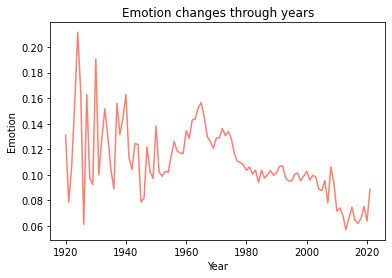

In [ ]:
plt.plot(emf.year, emf.emotion, color="salmon")
plt.xlabel("Year")
plt.ylabel("Emotion")
plt.title("Emotion changes through years");

The graph we plot above shows the change in Emotion over the years 1920 to 2020. The x axis represents the year and y axis represents the avarage amount of Emotion of the total songs for each year.I’d like to focus your attention on two key significant areas. First one is, There is a sudden drop and rise in a very short span of time in the 1920s. The second one is according to the graph it can be concluded that over the years emotion has decreased so emotion for each year and year is generally negatively correlated.

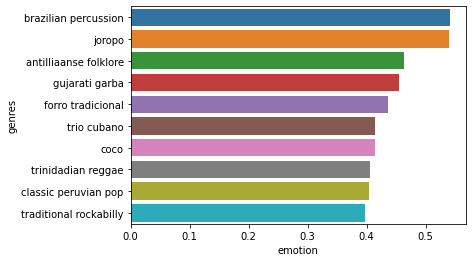

In [ ]:
emg = df_genres
emotion = emg["acousticness"]*emg["energy"]*emg["valence"]
#emotion = emg["acousticness"] + emg["energy"] + emg["valence"] # alternative to get rid of zero values
emg["emotion"] = tanh(emotion)
emg = emg.sort_values(by=["emotion"], ascending=False, ignore_index=1)
emg.head(10)

sns.barplot(x="emotion", y="genres", data=emg.head(10));

The graph we plot above shows the top 10 genres' relation with emotion.The x axis represents the emotion and y axis genres. An analysis of the graph illustrates that there is a positive correlation between the emotion and genres.

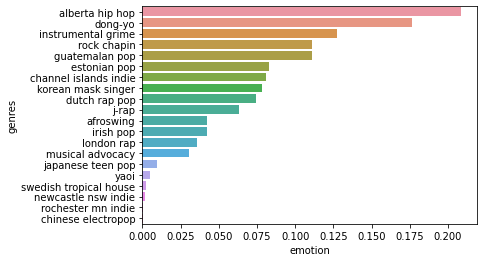

In [ ]:
emg = emg.sort_values(by=["popularity"], ascending=False, ignore_index=1)
sns.barplot(x="emotion", y="genres", data=emg.head(20).sort_values(by="emotion", ascending=0));

The graph we plot above shows the top 20 popular songs genres' relation with emotion.The x axis represents the emotion and y axis genres. An analysis of the graph illustrates that there is a positive correlation between the emotion and genres.

### Analysis of the Most Popular Artists and Songs

Top hundred most popular artists:

In [ ]:
ax = df_artist.sort_values(by=["popularity"], ascending=False, ignore_index=1)
bx = ax.head(100)
bx.head(100)

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count
0,CJ,0.19000,0.711,123429.0,0.598,0.000000,0.1500,-7.621,0.1820,140.175,0.737,94.0,3,0,2
1,Boza,0.36200,0.725,186133.0,0.756,0.000685,0.1030,-5.013,0.0572,100.070,0.828,92.0,4,1,2
2,Joel Corry,0.16800,0.734,166028.0,0.874,0.000011,0.0489,-3.158,0.0662,122.953,0.905,91.0,8,1,1
3,Juhn,0.12200,0.713,232853.0,0.617,0.000000,0.0962,-4.637,0.0887,168.021,0.682,91.0,8,1,2
4,Ritt Momney,0.05630,0.399,210463.0,0.491,0.000890,0.1100,-10.778,0.0538,91.066,0.151,89.0,6,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Shinsei Kamattechan,0.00447,0.447,90960.0,0.891,0.000905,0.3900,-4.776,0.0788,143.976,0.517,78.0,9,1,2
96,Mora,0.13200,0.550,232496.0,0.598,0.000003,0.0955,-5.402,0.0831,83.836,0.543,78.0,11,0,2
97,Matt Maltese,0.36500,0.331,218755.0,0.450,0.004640,0.2200,-5.362,0.0340,123.829,0.180,78.0,10,1,2
98,Studio Killers,0.00305,0.668,215280.0,0.798,0.014400,0.2770,-5.701,0.0334,133.928,0.575,78.0,11,1,2


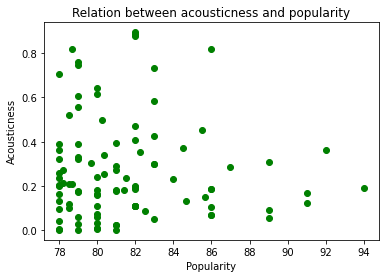

In [ ]:
plt.scatter(bx.popularity, bx.acousticness, color="green")
plt.ylabel("Acousticness")
plt.xlabel("Popularity")
plt.title("Relation between acousticness and popularity");

The graph we plot above shows relationship between acousticness and popularity. The x label represents popularity and y label acousticness.
From the graph we can say that there is a weak negative correlation between popularit and acousticness.

Top ten most popular songs:

In [ ]:
cx = df.sort_values(by=["popularity"], ascending=False, ignore_index=1)
dx = cx[['name','artists', 'popularity', 'year']]
cx = cx.head(1000)
dx = dx.head(100)
dx.head(10)

,name,artists,popularity,year
0,drivers license,['Olivia Rodrigo'],100,2021
1,Mood (feat. iann dior),"['24kGoldn', 'iann dior']",96,2020
2,positions,['Ariana Grande'],96,2020
3,DÁKITI,"['Bad Bunny', 'Jhay Cortez']",95,2020
4,BICHOTA,['KAROL G'],95,2020
5,34+35,['Ariana Grande'],94,2020
6,Whoopty,['CJ'],94,2020
7,WITHOUT YOU,['The Kid LAROI'],94,2020
8,Therefore I Am,['Billie Eilish'],94,2020
9,LA NOCHE DE ANOCHE,"['Bad Bunny', 'ROSALÍA']",94,2020


When best 1000 songs analysed, we can see that recent songs are more popular than older years.

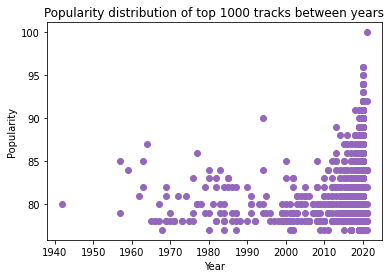

In [ ]:
plt.scatter(cx.year, cx.popularity, color="tab:purple")
plt.xlabel("Year")
plt.ylabel("Popularity")
plt.title("Popularity distribution of top 1000 tracks between years");

The graph we plot above shows the distrubiton of most most popular 1000 songs over the years 1940 to 2020. The x axis represents the years and y axis popularity.We’d like to focus your attention on two main areas. First one is from the graph we can see that between 1940-1950s there is almost no any popular song and second important thing is as the time passed popularity of the songs are increasing. As a result it can be concluded that recent songs are more popular than older songs.

### How Songs of Different Genres Change Over Time

Most popular genres

In [ ]:
ax = df_genres.sort_values(by=["popularity"], ascending=0, ignore_index=1)
bx = ax.head(100)
ax.head(10)

,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,emotion
0,chinese electropop,0.002570,0.660000,217088.000000,0.787000,0.000000,0.323000,-4.592000,0.0320,142.018000,0.199000,79.000000,1,0,0.000402
1,korean mask singer,0.238000,0.658000,199027.000000,0.749000,0.000002,0.272000,-2.967000,0.0634,128.909000,0.442000,78.000000,9,0,0.078629
2,yaoi,0.006550,0.603000,206180.000000,0.964000,0.000003,0.143000,-2.886000,0.0487,135.028000,0.796000,77.000000,8,0,0.005026
3,dutch rap pop,0.216000,0.767000,192452.000000,0.643000,0.000104,0.080600,-5.225000,0.1010,169.990000,0.536000,77.000000,5,1,0.074307
4,rochester mn indie,0.034700,0.655000,205766.000000,0.487000,0.897000,0.271000,-7.988000,0.0330,139.914000,0.045400,76.000000,6,1,0.000767
5,dong-yo,0.259000,0.829000,80927.000000,0.886000,0.000000,0.055900,-1.746000,0.1120,115.056000,0.777000,76.000000,8,1,0.176436
6,afroswing,0.171333,0.758333,188818.333333,0.512000,0.000033,0.101033,-7.562667,0.2110,102.061000,0.480333,75.333333,11,0,0.042111
7,j-rap,0.096100,0.648000,327967.000000,0.904000,0.000002,0.062900,-4.565000,0.0786,121.994000,0.728000,75.000000,6,0,0.063160
8,estonian pop,0.285000,0.458000,207069.000000,0.696000,0.000000,0.123000,-4.742000,0.0402,174.141000,0.418000,75.000000,11,1,0.082725
9,irish pop,0.308600,0.474750,212684.125000,0.513625,0.024295,0.146075,-8.183875,0.0577,111.043375,0.265238,74.625000,7,1,0.042017


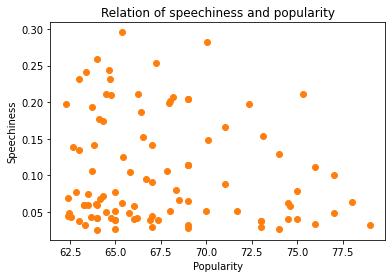

In [ ]:
plt.scatter(bx.popularity, bx.speechiness, color="tab:orange")
plt.xlabel("Popularity")
plt.ylabel("Speechiness")
plt.title("Relation of speechiness and popularity");

The graph we plot above shows the change in Speechiness over the Popularity. The x axis represents the popularity and y axis speechiness.From the graph we can say that while popularity is increasing the speechiness is decreasing and most popular songs have less speechiness. Therefore, it can be concluded that there is a negative correlation among speechiness amd popularity.

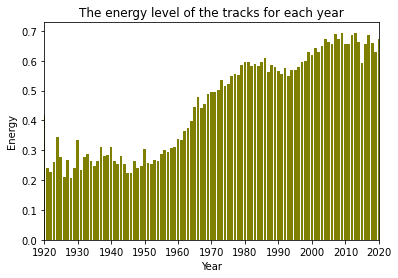

In [ ]:
plt.bar(df_year.year, df_year.energy, color="olive")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Energy")
plt.title("The energy level of the tracks for each year")
plt.show()

The graph we plot above shows the change in Energy level of the tracks over the years 1920 to 2020. The x axis represents the year and y axis represents the energy level of the tracks. An analysis of the graph illustrates that even though there are some decreases as in 1945s and 1960s, there is a positive correlation between the energy level of the tracks and years.

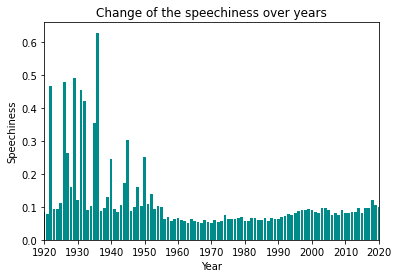

In [ ]:
plt.bar(df_year.year, df_year.speechiness, color="darkcyan")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Speechiness")
plt.title("Change of the speechiness over years")
plt.show()

The graph we plot above shows the change in Energy level of the tracks over the years 1920 to 2020. The x axis represents the year and y axis represents the energy level of the tracks. We’d like to focus your attention on two key significant areas. First one is, There are spikes and dips in the period from 1920 to 1950.The second one is according to the graph after the 1950s Speechiness has remained reasonably stable within the range 0.0 to 0.1. Overally, it can be concluded that as the time passed the Speechiness of the tracks has decreased.

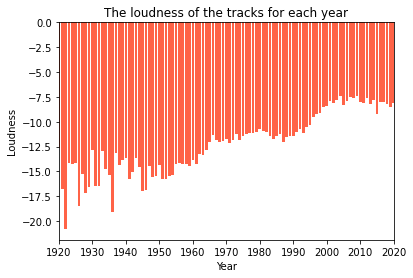

In [ ]:
plt.bar(df_year.year, df_year.loudness, color="tomato")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Loudness")
plt.title("The loudness of the tracks for each year")
plt.show()

The graph we plot above shows the change in loudness of the tracks over the yars 1920 to 2020. The x axis represents the years and y axis loudness of the tracks.Overall, this graph highlights that there is a strong positive correlation between loudness of the tracks and years.

####Merging year and genre datasets


In [ ]:
data = df
data.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,instrumentalness,liveness,loudness,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,['Mamie Smith'],0.598,168333,0.224,0,0.000522,0.3790,-12.628,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,150200,0.517,0,0.026400,0.0809,-7.261,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,['Mamie Smith'],0.647,163827,0.186,0,0.000018,0.5190,-12.098,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,['Oscar Velazquez'],0.730,422087,0.798,0,0.801000,0.1280,-7.311,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,['Mixe'],0.704,165224,0.707,1,0.000246,0.4020,-6.036,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


In [ ]:
data['artists'] = data['artists'].apply(str)
data['artists'] = data['artists'].apply(lambda x: re.findall(r'[\']([\w\s-]+)[\']', x))
data.head()

,acousticness,artists,danceability,duration_ms,energy,explicit,instrumentalness,liveness,loudness,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991000,[Mamie Smith],0.598,168333,0.224,0,0.000522,0.3790,-12.628,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.643000,[],0.852,150200,0.517,0,0.026400,0.0809,-7.261,I Put A Spell On You,7,1920-01-05,0.0534,86.889,0.9500,1920
2,0.993000,[Mamie Smith],0.647,163827,0.186,0,0.000018,0.5190,-12.098,Golfing Papa,4,1920,0.1740,97.600,0.6890,1920
3,0.000173,[Oscar Velazquez],0.730,422087,0.798,0,0.801000,0.1280,-7.311,True House Music - Xavier Santos & Carlos Gomi...,17,1920-01-01,0.0425,127.997,0.0422,1920
4,0.295000,[Mixe],0.704,165224,0.707,1,0.000246,0.4020,-6.036,Xuniverxe,2,1920-10-01,0.0768,122.076,0.2990,1920


In [ ]:
data.shape

(174389, 16)

In [ ]:
data = data.explode('artists')
data.tail()

,acousticness,artists,danceability,duration_ms,energy,explicit,instrumentalness,liveness,loudness,name,popularity,release_date,speechiness,tempo,valence,year
174384,0.00917,Tony T,0.792,147615,0.866,0,0.00006,0.178,-5.089,The One,0,2020-12-25,0.0356,125.972,0.186,2020
174385,0.79500,Alessia Cara,0.429,144720,0.211,0,0.00000,0.196,-11.665,A Little More,0,2021-01-22,0.0360,94.710,0.228,2021
174386,0.80600,Roger Fly,0.671,218147,0.589,0,0.92000,0.113,-12.393,Together,0,2020-12-09,0.0282,108.058,0.714,2020
174387,0.92000,Taylor Swift,0.462,244000,0.240,1,0.00000,0.113,-12.077,champagne problems,69,2021-01-07,0.0377,171.319,0.320,2021
174388,0.23900,Roger Fly,0.677,197710,0.460,0,0.89100,0.215,-12.237,Improvisations,0,2020-12-09,0.0258,112.208,0.747,2020


In [ ]:
data.shape

(229540, 16)

In [ ]:
genre = df_wgenres
genre.head()

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,genres
0,"""Cats"" 1981 Original London Cast",0.598500,0.470100,267072.000000,0.376203,0.010261,0.283050,-14.434300,0.209150,114.128800,0.358320,38.200000,5,1,10,['show tunes']
1,"""Cats"" 1983 Broadway Cast",0.862538,0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,31.538462,5,1,26,[]
2,"""Fiddler On The Roof” Motion Picture Chorus",0.856571,0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.571429,0,1,7,[]
3,"""Fiddler On The Roof” Motion Picture Orchestra",0.884926,0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.407407,0,1,27,[]
4,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.510714,0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,42.000000,5,1,7,[]


In [ ]:
genre[genre['artists'] == 'DJ Combo']

,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,genres
6186,DJ Combo,0.007943,0.7246,159714.733333,0.8356,0.025311,0.232213,-4.848,0.062493,126.532667,0.391667,0.2,9,0,15,[]


In [ ]:
merged = pd.merge(data, genre, on="artists")
merged.head()

,acousticness_x,artists,danceability_x,duration_ms_x,energy_x,explicit,instrumentalness_x,liveness_x,loudness_x,name,popularity_x,release_date,speechiness_x,tempo_x,valence_x,year,acousticness_y,danceability_y,duration_ms_y,energy_y,instrumentalness_y,liveness_y,loudness_y,speechiness_y,tempo_y,valence_y,popularity_y,key,mode,count,genres
0,0.991,Mamie Smith,0.598,168333,0.2240,0,0.000522,0.379,-12.628,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.634,1920,0.983,0.62725,177981.75,0.184556,0.000288,0.372625,-12.800313,0.121438,113.009938,0.641062,3.1875,0,1,16,"['harlem renaissance', 'traditional blues']"
1,0.993,Mamie Smith,0.647,163827,0.1860,0,0.000018,0.519,-12.098,Golfing Papa,4,1920,0.1740,97.600,0.689,1920,0.983,0.62725,177981.75,0.184556,0.000288,0.372625,-12.800313,0.121438,113.009938,0.641062,3.1875,0,1,16,"['harlem renaissance', 'traditional blues']"
2,0.992,Mamie Smith,0.782,195200,0.0573,0,0.000002,0.176,-12.453,Don't You Advertise Your Man,5,1920,0.0592,85.652,0.487,1920,0.983,0.62725,177981.75,0.184556,0.000288,0.372625,-12.800313,0.121438,113.009938,0.641062,3.1875,0,1,16,"['harlem renaissance', 'traditional blues']"
3,0.995,Mamie Smith,0.482,198000,0.2290,0,0.000061,0.549,-12.619,Kansas City Man Blues - 78rpm Version,4,1920,0.0812,77.232,0.461,1920,0.983,0.62725,177981.75,0.184556,0.000288,0.372625,-12.800313,0.121438,113.009938,0.641062,3.1875,0,1,16,"['harlem renaissance', 'traditional blues']"
4,0.992,Mamie Smith,0.574,189800,0.1380,0,0.000492,0.233,-14.171,Miss Jenny's Ball (aka There'll Be No Freebies...,1,1920,0.1090,158.422,0.764,1920,0.983,0.62725,177981.75,0.184556,0.000288,0.372625,-12.800313,0.121438,113.009938,0.641062,3.1875,0,1,16,"['harlem renaissance', 'traditional blues']"


In [ ]:
merged.shape

(218703, 31)

In [ ]:
merged.columns

Index(['acousticness_x', 'artists', 'danceability_x', 'duration_ms_x',
       'energy_x', 'explicit', 'instrumentalness_x', 'liveness_x',
       'loudness_x', 'name', 'popularity_x', 'release_date', 'speechiness_x',
       'tempo_x', 'valence_x', 'year', 'acousticness_y', 'danceability_y',
       'duration_ms_y', 'energy_y', 'instrumentalness_y', 'liveness_y',
       'loudness_y', 'speechiness_y', 'tempo_y', 'valence_y', 'popularity_y',
       'key', 'mode', 'count', 'genres'],
      dtype='object')

In [ ]:
frameMerged = merged
selectedGenre = ["pop"]
pop_Data = frameMerged.genres.apply(lambda x: any(item for item in selectedGenre if item in x))
pop_DataFiltered = frameMerged[pop_Data]

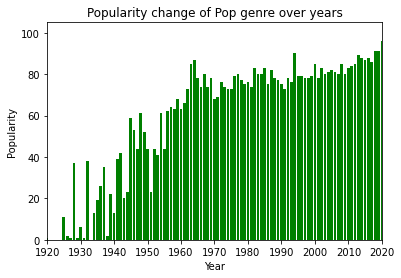

In [ ]:
plt.bar(pop_DataFiltered.year, pop_DataFiltered.popularity_x, color="green")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Popularity")
plt.title("Popularity change of Pop genre over years")
plt.show()

The graph we plot above shows the change in popularity of the pop genre over years 1920 to 2020. 
The x axis represents the year and y popularity of pop genres.
An analysis of the graph illustrates that as the time passed the popularity of pop genres increased.
Therefore, it can be concluded that there is a positive correlation between popularity of pop genres and years.

In [ ]:
frameMerged = merged
selectedGenre = ["rock"]
rock_Data = frameMerged.genres.apply(lambda x: any(item for item in selectedGenre if item in x))
rock_DataFiltered = frameMerged[rock_Data]

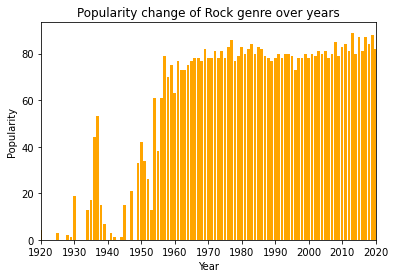

In [ ]:
plt.bar(rock_DataFiltered.year, rock_DataFiltered.popularity_x, color="orange")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Popularity")
plt.title("Popularity change of Rock genre over years")
plt.show()

The graph we plot above shows the change in popularity of the rock genre over years 1920 to 2020. 
The x axis represents the year and y popularity of rock genres.
We’d like to focus your attention on two key significant areas. First one is, starting from the 1950s
there is a sharp increase in the popularity of rock genre and the second one is as the year passed 
the popularity of rock genre has increased.

In [ ]:
frameMerged = merged
selectedGenre = ["jazz"]
jazz_Data = frameMerged.genres.apply(lambda x: any(item for item in selectedGenre if item in x))
jazz_DataFiltered = frameMerged[jazz_Data]

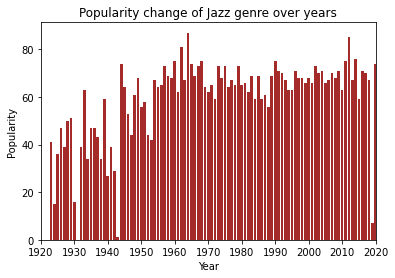

In [ ]:
plt.bar(jazz_DataFiltered.year, jazz_DataFiltered.popularity_x, color="brown")
plt.xlabel("Year")
plt.xlim(1920, 2020)
plt.xticks(np.linspace(1920,2020,11))
plt.ylabel("Popularity")
plt.title("Popularity change of Jazz genre over years")
plt.show()

The graph we plot above shows the change in popularity of the jazz genre over years 1920 to 2020.
The x axis represents the year and y popularity of jazz genres. Acording to graph, apart from some years jazz has always been a popular genre 
from 1920 to 2020

## Hypothesis Testing

###Hypothesis Test 1 (Acousticness - Popularity)

Hypothesis Test: We want to test whether there is significant differences in terms of Popularity over years for different acousticness levels.

**Null Hypothesis ($H_0$)**: Means of `popularity` samples for all acousticness levels are same. (e.g. $a_1$ denotes low level acousticness sample)

$ H_0: \mu_{a_1} = \mu_{a_2} = \mu_{c_3}$

**Alternative Hypothesis ($H_A$)**: Means of `popularity` samples for all acousticness levels are different.

$ H_A:$ Means $\mu_{a_1}, \mu_{a_2}, \mu_{a_3}$ are not same.

**Significance level**: As most of hypothesis tests assume significance level as `0.05`, we are setting it as `0.05` for our test too.

In [ ]:
#subset we are going to use in our hypothesis test
data_h = df[['acousticness','popularity','year']]
data_h.head()

,acousticness,popularity,year
0,0.991000,12,1920
1,0.643000,7,1920
2,0.993000,4,1920
3,0.000173,17,1920
4,0.295000,2,1920


####Acousticness levels

In [ ]:
#Creating 3 levels for acousticness levels

a_low = data_h[data_h["acousticness"] < 1.0/3.0].sort_values(by=['acousticness'])
a_med = data_h[(data_h["acousticness"] < 2.0/3.0) & (data_h["acousticness"] > 1.0/3.0)].sort_values(by=['acousticness'])
a_high = data_h[data_h["acousticness"] > 2.0/3.0].sort_values(by=['acousticness'])
a_low.head()

,acousticness,popularity,year
173025,0.0,55,2015
167400,0.0,30,1987
62458,0.0,0,1949
152345,0.0,31,1987
18946,0.0,71,2015


In [ ]:
#we excluded popularity 0 tracks from our subsets because these tracks are not
#known by the major audience and thus didnt recieved enough attention to compare
#with acoustics accurately

#comment following 3 lines to include
a_low = a_low[a_low["popularity"] > 0.0]
a_med = a_med[a_med["popularity"] > 0.0]
a_high = a_high[a_high["popularity"] > 0.0]

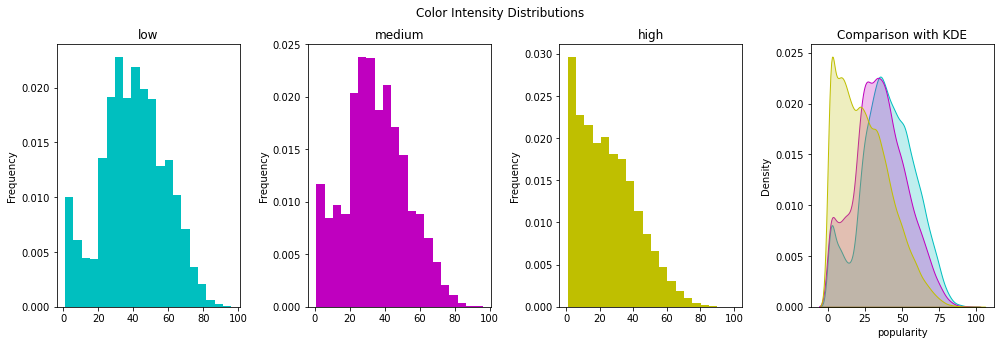

In [ ]:
fig, ax = plt.subplots(1, 4, figsize=(14,5))
        
a_low['popularity'].plot(kind="hist", ax=ax[0], bins=20, label="low", color="c", density=True)
ax[0].set_title("low")

a_med['popularity'].plot(kind="hist", ax=ax[1], bins=20, label="medium", color="m", density=True)
ax[1].set_title("medium")

a_high['popularity'].plot(kind="hist", ax=ax[2], bins=20, label="high", color="y", density=True)
ax[2].set_title("high")

sns.kdeplot(a_low['popularity'], shade=True, label="low", ax=ax[3], color="c")
sns.kdeplot(a_med['popularity'], shade=True, label="medium", ax=ax[3], color="m")
sns.kdeplot(a_high['popularity'], shade=True, label="high", ax=ax[3], color="y")
ax[3].set_title("Comparison with KDE")

plt.suptitle("Color Intensity Distributions")
# To avoid suptitle and titles of ax titles colliding
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

Since we want to test 3 samples simultaneously, ANOVA is a test that we can apply here. Below, we introduce our samples to ANOVA test.

####Anova Test

In [ ]:
f_stats, p_values = f_oneway(a_low['popularity'].values, a_med['popularity'].values, a_high['popularity'].values)
p_values

0.0

####Results:

> As p-value we obtained is smaller than the threshold significance level 0.05, we can conclude that means of acousticness samples are not the same. Here, we reject the null hypothesis.

###Hypothesis Test 2 (Energy - Years)

Hypothesis Test: We want to test whether there is significant differences in terms of energy in Pop genre between two periods of time.

**Null Hypothesis ($H_0$)**: Means of `energy` samples of Pop genre for different periods of times are the same. (e.g. $e_1$ denotes first time period)

$ H_0: \mu_{e_1} = \mu_{e_2}$

**Alternative Hypothesis ($H_A$)**: Means of `energy` samples of Pop genre for different periods of time are different.

$ H_A:$ Means $\mu_{e_1}, \mu_{e_2}$ are not same.

**Significance level**: As most of hypothesis tests assume significance level as `0.05`, we are setting it as `0.05` for our test too.

####Time periods:
1. 1930-1950 (World wars period)
2. 2000-2015 (modern period)



In [ ]:
#Energy and Year features for Pop genre
selection = ["pop"]
data_h3 = merged.genres.apply(lambda x: any(item for item in selection if item in x))
data_h4 = merged[data_h3]
data_h4 = data_h4.rename(columns={"energy_y":"energy"})
data_pop = data_h4[["energy","year"]]
data_pop.head()

,energy,year
2343,0.39825,1920
2344,0.39825,1920
2345,0.39825,1920
2346,0.39825,1920
2347,0.39825,1920


In [ ]:
era1 = data_pop[(data_pop["year"] >= 1935) & (data_pop["year"] <= 1950)] #1930-1950
era2 = data_pop[(data_pop["year"] >= 2000) & (data_pop["year"] <= 2020)] #2000-2020
print("1930-1950")
display(era1.head())
print("2000-2020")
display(era2.head())

1930-1950


,energy,year
9733,0.142745,1936
16472,0.223402,1936
16473,0.223402,1936
16474,0.223402,1941
16475,0.223402,1941


2000-2020


,energy,year
16532,0.223402,2011
16567,0.223402,2006
16631,0.223402,2006
36339,0.359441,2002
36371,0.359441,2006


Checking if there is any significant differencess between these eras.

In [ ]:
era1_m = era1["energy"]
era2_m = era2["energy"]
print(f"mean of energy of tracks between 1930-1950: {era1_m.mean():.2f}")
print(f"standart derivasion of energy of tracks between 1930-1950: {era1_m.std():.2f}")
print("\n")
print(f"mean of energy of tracks between 2000-2020: {era2_m.mean():.2f}")
print(f"standart derivation of energy of tracks between 2000-2020: {era2_m.std():.2f}")


mean of energy of tracks between 1930-1950: 0.30
standart derivasion of energy of tracks between 1930-1950: 0.11


mean of energy of tracks between 2000-2020: 0.66
standart derivation of energy of tracks between 2000-2020: 0.15


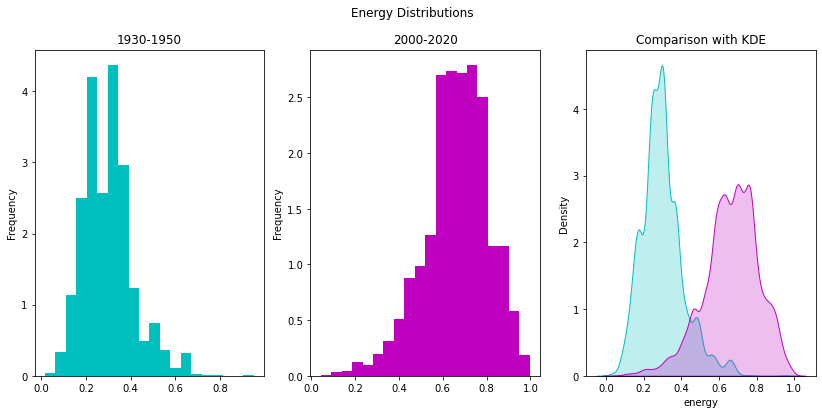

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(14,6))  # a figure with 1 row and 3 columns
                                              # ax variable stores a list with 3 elements
                                              # each element in ax correspons to chart
        
era1_m.plot(kind="hist", ax=ax[0], bins=20, label="1930-1950", color="c", density=True)
ax[0].set_title("1930-1950")

era2_m.plot(kind="hist", ax=ax[1], bins=20, label="2000-2020", color="m", density=True)
ax[1].set_title("2000-2020")

sns.kdeplot(era1_m, shade=True, label="1930-1950", ax=ax[2], color="c")
sns.kdeplot(era2_m, shade=True, label="2000-2020", ax=ax[2], color="m")
ax[2].set_title("Comparison with KDE")

plt.suptitle("Energy Distributions")
plt.show()

####T-Test
Applying two-sample t-test to our two era samples

In [ ]:
stats.ttest_ind(era1_m, era2_m, equal_var = False)

Ttest_indResult(statistic=-149.89801098310886, pvalue=0.0)

####Results:

Because we set the significance level as 0.05, we can reject the null hypothesis. Also, test score is negative which means energies of tracks from era2 (2000-2020) are higher than era1 (1930-1950). 

##Machine Learning

###Feature Selection

In order to select most appropriate features for the model, we used the correlation heat map.

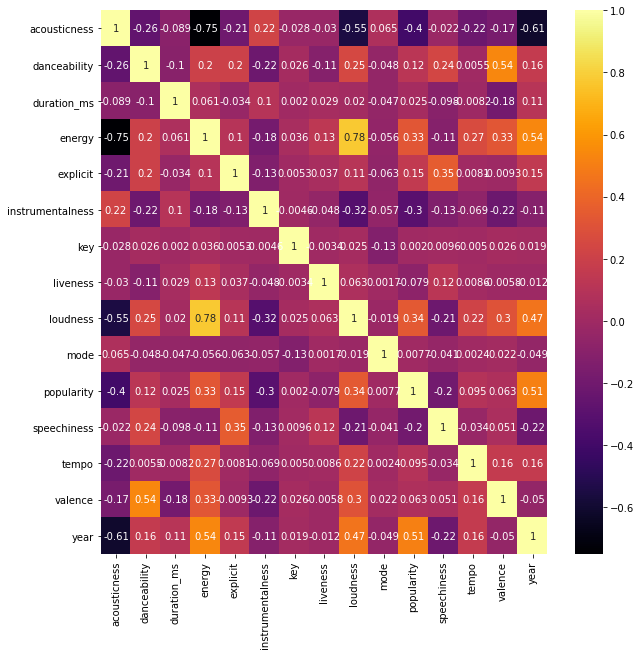

In [ ]:
fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(df.corr("pearson"),annot = True,cmap = "inferno");

id and name features are dropped becuase it is unique for every track and it cant assist the model.
Also release date is dropped.

In [ ]:
X = df[["year","acousticness","loudness", "energy","explicit", "valence", "duration_ms", "danceability", "instrumentalness", "liveness", "tempo"]]
y = df["popularity"]

###Feature Transforming

* There were no empty values in the dataset, so nothing to eliminate.
* we decieded to scale year and loudness to match with other features.

In [ ]:
X.year = (X.year - df.year.min()) / (df.year.max() - df.year.min())
X.loudness = (X.loudness- df.loudness.min())/ (df.loudness.max() - df.loudness.min())

We split the data into test, train and validation sets to use in upcoming models. Split ratio => (train= 70% | validation= 15% | test= 15%)

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.15, random_state=1)

X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=(15.0/85.0), random_state=1)

###Model Building

####Linear Regression

First we tried the simplest mahine learning method, linear regression.




In [ ]:
model = LinearRegression()  
model.fit(X_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [ ]:
y_pred = model.predict(X_val)

mse = mean_squared_error(y_val, y_pred)
mae = mean_absolute_error(y_val, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_val, y_pred)

print("mse: {}".format(mse))
print("mae: {}".format(mae))
print("rmse: {}".format(rmse))
print("R2 score: {}".format(r2))

mse: 316.4988137594009
mae: 13.78716618613261
rmse: 17.790413535367886
R2 score: 0.3454497293706953


As expected, linear regression yielded a poor result.

Visualization of Linear regression model predictions

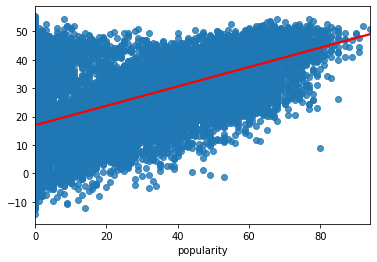

In [ ]:
sns.regplot(x=y_val, y=y_pred, line_kws={"color":"red"});

####Polynomial Regression

In order to decrease the mean square error we tried polynomial regresion.
after testing we found most fitting order as 2.

In [ ]:
order = 2
poly = PolynomialFeatures(order)
poly_X_train = poly.fit_transform(X_train)
pol_reg = LinearRegression()
pol_reg.fit(poly_X_train, y_train)

y_pred = pol_reg.predict(poly.fit_transform(X_val))

In [ ]:
mse = mean_squared_error(y_val, y_pred)
mae = mean_absolute_error(y_val, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_val, y_pred)

print("mse: {}".format(mse))
print("mae: {}".format(mae))
print("rmse: {}".format(rmse))
print("R2 score: {}".format(r2))

mse: 234.4689755425342
mae: 11.761851615899749
rmse: 15.3123798131621
R2 score: 0.5150953977596605


Visualization of Polynomial regression model predictions

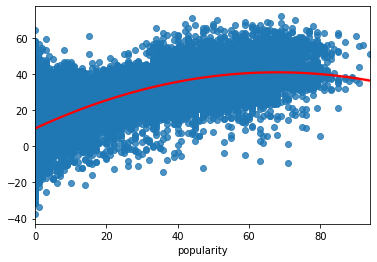

In [ ]:
sns.regplot(x=y_val, y=y_pred, line_kws={"color":"red"}, order=order);

####Decision tree


In [ ]:
tree = DecisionTreeRegressor(criterion='mse', splitter='best', max_depth=3, min_samples_split=2, min_samples_leaf=1, max_features=11, random_state=1, max_leaf_nodes=None)
model = tree.fit(X_train, y_train)
y_train_pred = tree.predict(X_train)

In [ ]:
mse_train = mean_squared_error(y_train, y_train_pred)


train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))

y_val_pred = tree.predict(X_val)

mse_val = mean_squared_error(y_val, y_val_pred)
val_rmse = np.sqrt(mean_squared_error(y_val, y_val_pred))

r2_train = r2_score(y_train, y_train_pred)
r2_val = r2_score(y_val, y_val_pred)

mae = (abs(y_val - y_val_pred)).mean()


train_rmse, val_rmse, r2_train, r2_val, y_train_pred, y_val_pred, mae= train_rmse, val_rmse, r2_train, r2_val, y_train_pred, y_val_pred, mae

In [ ]:
print("Mean Squared Error for Train dataset is {}". format(mse_train))
print("Mean Squared Error for test dataset is {}". format(mse_val))
print("Root Mean Squared Error for Train dataset is {}". format(train_rmse))
print("Root Mean Squared Error for Test dataset is {}". format(val_rmse))
print("r2-score for Train Dataset is {}".format(r2_train))
print("r2-score for Test Dataset is {}" .format(r2_val))
print("Mean Absolute Error for Test dataset is {}" . format(mae))

Mean Squared Error for Train dataset is 242.1661021686416
Mean Squared Error for test dataset is 246.22285434143288
Root Mean Squared Error for Train dataset is 15.561686996230248
Root Mean Squared Error for Test dataset is 15.691489870035696
r2-score for Train Dataset is 0.49236185352607165
r2-score for Test Dataset is 0.4907872354086581
Mean Absolute Error for Test dataset is 11.239853453186084


Visualization of the Decision Tree Model

In [ ]:
from sklearn import datasets
from sklearn import tree
text_representation = tree.export_text(model)
print(text_representation)

|--- feature_0 <= 0.36
|   |--- feature_0 <= 0.33
|   |   |--- feature_0 <= 0.28
|   |   |   |--- value: [1.76]
|   |   |--- feature_0 >  0.28
|   |   |   |--- value: [3.68]
|   |--- feature_0 >  0.33
|   |   |--- feature_0 <= 0.35
|   |   |   |--- value: [8.78]
|   |   |--- feature_0 >  0.35
|   |   |   |--- value: [15.90]
|--- feature_0 >  0.36
|   |--- feature_8 <= 0.20
|   |   |--- feature_0 <= 0.45
|   |   |   |--- value: [22.73]
|   |   |--- feature_0 >  0.45
|   |   |   |--- value: [38.54]
|   |--- feature_8 >  0.20
|   |   |--- feature_0 <= 0.86
|   |   |   |--- value: [30.87]
|   |   |--- feature_0 >  0.86
|   |   |   |--- value: [9.50]



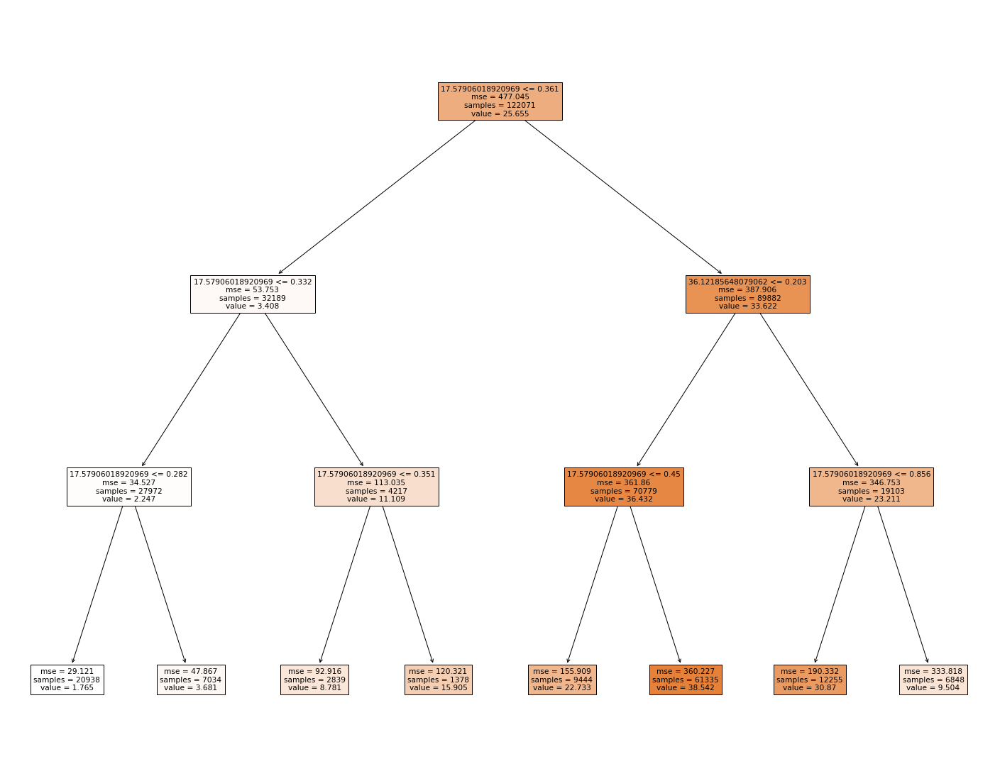

In [ ]:
fig = plt.figure(figsize=(25,20))
_ = tree.plot_tree(model, feature_names=y_pred, filled=True)

####Random Forest

In [ ]:

params = {'bootstrap': True,'max_features': 11,'min_samples_split': 10,'n_estimators': 100,"random_state":1}
forest = RandomForestRegressor(**params)


In [ ]:
forest.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features=11, max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=10, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=1, verbose=0, warm_start=False)

In [ ]:
y_pred = forest.predict(X_val)
mse = mean_squared_error(y_val, y_pred)
mae = mean_absolute_error(y_val, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_val, y_pred)

print("mse: {}".format(mse))
print("mae: {}".format(mae))
print("rmse: {}".format(rmse))

print("R2 score: {}".format(r2))

mse: 153.51227681383335
mae: 8.340296708885555
rmse: 12.39000713534231
R2 score: 0.6825217095132611


####Hyperparameter Tuning

Grid search


In [ ]:
param_grid = {
    'bootstrap': [True],
    'max_depth': [None, 2, 4],
    'max_features': [11],
    'min_samples_split': [2, 4],
    'n_estimators': [100, 150, 200],
    'random_state':[1]
}
rf = RandomForestRegressor()
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid)

In [ ]:
# Fit the grid search to the data
grid_search.fit(X_train, y_train)
grid_search.best_params_

{'bootstrap': True,
 'max_depth': None,
 'max_features': 11,
 'min_samples_split': 2,
 'n_estimators': 150,
 'random_state': 1}

In [ ]:
grid_search.predict(X_val)

array([ 1.68666667,  0.        ,  4.66666667, ..., 42.11666667,
       35.24      ,  0.13333333])

In [ ]:
y_pred = grid_search.predict(X_val)
mse = mean_squared_error(y_val, y_pred)
mae = mean_absolute_error(y_val, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_val, y_pred)

print("mse: {}".format(mse))
print("mae: {}".format(mae))
print("rmse: {}".format(rmse))

print("R2 score: {}".format(r2))

mse: 151.65946736305295
mae: 8.27738844712354
rmse: 12.315009840152502
R2 score: 0.6863534993169182


With the optimal parameters acquired from grid search we got a slightly lower mse value.

###Conclusion

**Comparison of Regression Models:**
* Linear Regression        : 
  * mse: 316.4988137594009
  * mae: 13.78716618613261
  * rmse: 17.790413535367886
  * R2 score: 0.3454497293706953
* Polynomial Regression    :
  * mse: 234.4689755425342
  * mae: 11.761851615899749
  * rmse: 15.3123798131621
  * R2 score: 0.5150953977596605
* Decision Tree Regression :
  * mse: 246.22285434143288
  * mae: 11.239853453186084
  * rmse 15.691489870035696
  * R2 score: 0.4907872354086581
* Random Forest Regression :
  * mse: 151.65946736305295
  * mae: 8.27738844712354
  * rmse: 12.315009840152502
  * R2 score: 0.6863534993169182


As expected, Random Forest method yielded the best results with an r^2 score of 0.686

###Simple Song Recommendation System




In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from os.path import join
%matplotlib inline

Before the actual recommendation system, we prepared an even simpler one by randomly picking a track from the dataframe. Of course, this is not a serious attempt but it kind of fits the description :)

In [ ]:
import random
print("Welcome to random recomendation system!")
input_list_text = input("Enter list of songs: ")
input_list = input_list_text.split(",")
choice = random.choice(df.name)
print("Song recomendation according to your tastes O.o :")
print(choice)

Welcome to random recomendation system!
Enter list of songs: Serdar Ortac - Karabiberim
Song recomendation according to your tastes O.o :
Does My Breath Smell?


####Clustering Genres with k-means

And now, for the actual recommendation system, we prepared a simple system where we utilised clustering and k-means method

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])
X = df_genres.select_dtypes(np.number)
cluster_pipeline.fit(X)
df_genres['cluster'] = cluster_pipeline.predict(X)

Visualization of Genre Clusters

In [ ]:
from sklearn.manifold import TSNE
import plotly.express as px 

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = df_genres['genres']
projection['cluster'] = df_genres['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 3232 samples in 0.005s...
[t-SNE] Computed neighbors for 3232 samples in 0.309s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3232
[t-SNE] Computed conditional probabilities for sample 2000 / 3232
[t-SNE] Computed conditional probabilities for sample 3000 / 3232
[t-SNE] Computed conditional probabilities for sample 3232 / 3232
[t-SNE] Mean sigma: 0.789973
[t-SNE] Computed conditional probabilities in 0.141s
[t-SNE] Iteration 50: error = 82.9647980, gradient norm = 0.0164685 (50 iterations in 1.825s)
[t-SNE] Iteration 100: error = 76.4391556, gradient norm = 0.0035165 (50 iterations in 1.303s)
[t-SNE] Iteration 150: error = 76.2136459, gradient norm = 0.0006188 (50 iterations in 1.149s)
[t-SNE] Iteration 200: error = 76.1942749, gradient norm = 0.0002999 (50 iterations in 1.172s)
[t-SNE] Iteration 250: error = 76.1886902, gradient norm = 0.0001838 (50 iterations in 1.191s)
[t-SNE] KL divergence after 250 iterati

As you can see, genres are seperated into a set number of clusters.

####Clustering Songs with k-means

In [ ]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2, n_jobs=4))],verbose=True)

X = df.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
df['cluster_label'] = song_cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............ (step 2 of 2) Processing kmeans, total=  28.9s


Visualization of Song Clusters

In [ ]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
embed_track = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=embed_track)
projection['title'] = df['name']
projection['cluster'] = df['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', color_continuous_scale='tropic', hover_data=['x', 'y', 'title'])
fig.show()

####Simple Song Recommender

In [ ]:
from scipy.spatial.distance import cdist
from sklearn.metrics import euclidean_distances
from collections import defaultdict
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def recommend_songs( list_tracks, data_tracks, n_tracks=10):
    
    metadata_cols = ['name', 'year', 'artists']

    #We put the features of the track input to a dictionary by flattening it
    flattened_dict = defaultdict()
    for key in list_tracks[0].keys():
        flattened_dict[key] = []
    
    for dictionary in list_tracks:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    dict_track = flattened_dict

    track_vectors = []
    
    #Here, we find the given track in the dataframe
    for track in list_tracks:
        track_data = data_tracks[(data_tracks['name'] == track['name']) & (data_tracks['year'] == track['year'])].iloc[0]

        if track_data is None:
            print('Warning: {} doesn\'t exist in database'.format(track['name']))
            continue
        track_vector = track_data[number_cols].values
        track_vectors.append(track_vector)  
    
    track_matrix = np.array(list(track_vectors))
    
    #Then we locate the track in the cluster map and pick the closest "n_tracks" amount of tracks
    track_center = np.mean(track_matrix, axis=0)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(data_tracks[number_cols])
    scaled_song_center = scaler.transform(track_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_tracks+1][0])
    
    rec_songs = data_tracks.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(dict_track['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

example of 5 song recommendations for input song "Therefore I Am". 

In [ ]:
number_of_songs = 5  #Number of songs to be recommended
recommended_songs = recommend_songs([{'name': 'Therefore I Am', 'year':2020}], df, number_of_songs)
for song in recommended_songs:
  pprint(song)

{'artists': "['Germán Montero']", 'name': 'Amantes Escondidos', 'year': 2007}
{'artists': "['a-ha']", 'name': "There's Never a Forever Thing", 'year': 1988}
{'artists': "['PARTYNEXTDOOR']", 'name': 'PERSIAN RUGS', 'year': 2020}
{'artists': "['Junior H']", 'name': 'No Eh Cambiado', 'year': 2019}
{'artists': "['Fetty Wap']", 'name': 'RGF Island', 'year': 2015}
